# Video Classification using HMDB Dataset

In [45]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [49]:
! pip install patool
! pip install imageio
! pip install git+https://github.com/tensorflow/docs

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-rgo7ho99
  Running command git clone --filter=blob:none --quiet https://github.com/tensorflow/docs /tmp/pip-req-build-rgo7ho99
  Resolved https://github.com/tensorflow/docs to commit 84bd7bea0c468667dd0ec273d426ed50f23e1a15
  Preparing metadata (setup.py) ... done
  Created wheel for tensorflow-docs: filename=tensorflow_docs-0.0.0.dev0-py3-none-any.whl size=182618 sha256=6fc42969ef4514df4bee6bb6364af050cb95d60b03d15bdca3bece100cc05bb1
  Stored in directory: /tmp/pip-ephem-wheel-cache-2huz8hrs/wheels/fc/f8/3b/5d21409a59cb1be9b1ade11f682039ced75b84de9dd6a0c8de
Successfully built tensorflow-docs


Library Import

In [52]:
import numpy as np
import pandas as pd
import h5py
import zipfile
import cv2
import shutil
import zipfile
import os
import imageio
import zipfile
import gc
import copy
import math
import warnings
import random
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import albumentations as A
import torchvision
import torchvision.transforms.functional as TF
import torchvision.transforms as transforms
import patoolib
import torch.utils.data as data_utils
import torch
import torchvision
import torchvision.transforms as transforms
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
import PIL
import torch.utils.data as data_utils

# import xml.etree.ElementTree as ET # Parse XML Data.
import tensorflow_docs.vis.embed as embed
# import IPython

# from maskedtensor import masked_tensor

# from sklearn.metrics import confusion_matrix, roc_curve
# from sklearn.preprocessing import LabelEncoder

In [29]:
from IPython.display import Image
# from scipy import ndimage
# from PIL import Image
from torch.utils.data import Dataset
from plotly.subplots import make_subplots
from matplotlib import pyplot as plt
from torch.nn.utils.rnn import pack_padded_sequence, pad_packed_sequence, pad_sequence
# from sklearn.preprocessing import LabelBinarizer
# from sklearn.model_selection import train_test_split
# from sklearn.metrics import classification_report
# from tensorflow.python.client import device_lib
from zipfile import ZipFile
from IPython import display
from torchvision import models, transforms
from google.colab.patches import cv2_imshow
# from maskedtensor import masked_tensor

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

## Data Preparation

Dataset Download

In [6]:
! wget http://serre-lab.clps.brown.edu/wp-content/uploads/2013/10/hmdb51_org.rar

--2023-04-16 14:18:09--  http://serre-lab.clps.brown.edu/wp-content/uploads/2013/10/hmdb51_org.rar
Resolving serre-lab.clps.brown.edu (serre-lab.clps.brown.edu)... 128.148.254.114
Connecting to serre-lab.clps.brown.edu (serre-lab.clps.brown.edu)|128.148.254.114|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://serre-lab.clps.brown.edu/wp-content/uploads/2013/10/hmdb51_org.rar [following]
--2023-04-16 14:18:09--  https://serre-lab.clps.brown.edu/wp-content/uploads/2013/10/hmdb51_org.rar
Connecting to serre-lab.clps.brown.edu (serre-lab.clps.brown.edu)|128.148.254.114|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2124008126 (2.0G)
Saving to: ‘hmdb51_org.rar’

hmdb51_org.rar      100%[===================>]   1.98G  88.6MB/s    in 23s     

2023-04-16 14:18:33 (86.8 MB/s) - ‘hmdb51_org.rar’ saved [2124008126/2124008126]



In [7]:
! rm -rf hmbd51_dir
! mkdir hmdb51_dir
! unrar e hmdb51_org.rar hmdb51_dir/


UNRAR 5.61 beta 1 freeware      Copyright (c) 1993-2018 Alexander Roshal


Extracting from hmdb51_org.rar

Extracting  hmdb51_dir/shoot_gun.rar                                       0%  1%  OK 
Extracting  hmdb51_dir/sit.rar                                             1%  2%  3%  OK 
Extracting  hmdb51_dir/situp.rar                                           3%  4%  OK 
Extracting  hmdb51_dir/smile.rar                                           4%  5%  OK 
Extracting  hmdb51_dir/smoke.rar                                           5%  6%  7%  OK 
Extracting  hmdb51_dir/somersault.rar                                      7%  8%  9%  OK 
Extracting  hmdb51_dir/stand.rar                                           9% 10% 11%  OK 
Extracting  hmdb51_dir/swing_baseball.rar                                 11% 12% 13%  OK 
Extracting  hmdb51_dir/sword.rar                    

In [8]:
! mkdir hmbd51_videos
rar_files = os.listdir("hmdb51_dir")

for rar_file in rar_files:
  patoolib.extract_archive(f"hmdb51_dir/{rar_file}", outdir="./hmbd51_videos/")

patool: Extracting hmdb51_dir/chew.rar ...
patool: running /usr/bin/unrar x -- /content/hmdb51_dir/chew.rar
patool:     with cwd='./hmbd51_videos/'
patool: ... hmdb51_dir/chew.rar extracted to `./hmbd51_videos/'.
patool: Extracting hmdb51_dir/swing_baseball.rar ...
patool: running /usr/bin/unrar x -- /content/hmdb51_dir/swing_baseball.rar
patool:     with cwd='./hmbd51_videos/'
patool: ... hmdb51_dir/swing_baseball.rar extracted to `./hmbd51_videos/'.
patool: Extracting hmdb51_dir/catch.rar ...
patool: running /usr/bin/unrar x -- /content/hmdb51_dir/catch.rar
patool:     with cwd='./hmbd51_videos/'
patool: ... hmdb51_dir/catch.rar extracted to `./hmbd51_videos/'.
patool: Extracting hmdb51_dir/handstand.rar ...
patool: running /usr/bin/unrar x -- /content/hmdb51_dir/handstand.rar
patool:     with cwd='./hmbd51_videos/'
patool: ... hmdb51_dir/handstand.rar extracted to `./hmbd51_videos/'.
patool: Extracting hmdb51_dir/pour.rar ...
patool: running /usr/bin/unrar x -- /content/hmdb51_dir/p

## Data Preprocessing

In [4]:
base_path = f"hmbd51_videos"
class_names = os.listdir(f"{base_path}")

# from IPython.display import Image, display

# for class_name in class_names:
#   first_video_of_a_class = os.listdir(f"{base_path}/{class_name}")[0]
#   full_first_video_path = f"{base_path}/{class_name}/{first_video_of_a_class}"
#   video_frames = get_all_frames_from_video(full_first_video_path)

#   convert_frames_to_gif(video_frames)
#   print(f"Preview for Class Name: {class_name}")
#   preview_gif("sample.gif")

In [5]:
print(models.inception_v3(pretrained = True))

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Inception3(
  (Conv2d_1a_3x3): BasicConv2d(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2a_3x3): BasicConv2d(
    (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2b_3x3): BasicConv2d(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (maxpool1): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv2d_3b_1x1): BasicConv2d(
    (conv): Conv2d(64, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_4a_3x3): BasicConv2d(
    (conv): Conv2d(80, 192, kernel_size=(3, 3), stri

Define Pytorch Feature Extractor

In [72]:
class VGG19FeatureExtractor(nn.Module):
  def __init__(self):
    super(VGG19FeatureExtractor, self).__init__()
    self.pretrained_model = nn.Sequential(
        models.vgg19(pretrained = True).features,
        nn.AdaptiveAvgPool2d(output_size=(7, 7)),
        nn.Flatten(),
    )
    self.pretrained_model.requires_grad_ = False

  def forward(self, x):
    x = self.pretrained_model(x)
    x = x.view(25088)
    return x

vgg32_feature_extractor = VGG19FeatureExtractor().to(device)
vgg32_feature_extractor.requires_grad_ = False
vgg32_feature_extractor

VGG19FeatureExtractor(
  (pretrained_model): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU(inplace=True)
      (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (8): ReLU(inplace=True)
      (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (11): ReLU(inplace=True)
      (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (13): ReLU(inplace=True)
      (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (15): ReLU(i

Visualize 1 video for each class.

Make sure to convert into GIF Files first.

Preview for Class Name: clap


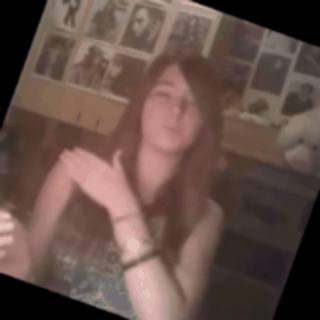

Preview for Class Name: fencing


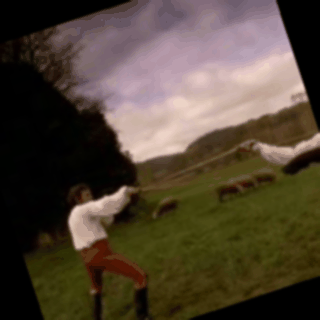

Preview for Class Name: swing_baseball


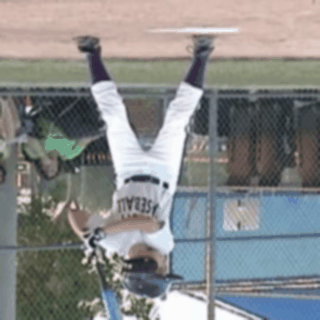

Preview for Class Name: jump


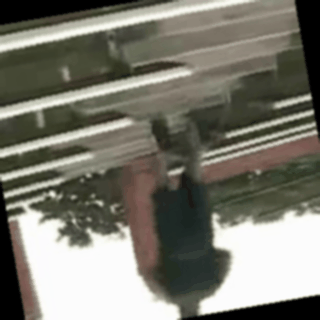

In [68]:
def train_video_preprocessing(frame, rotate, is_hflip, is_vlip, kernel_size = (5, 5)):
  def lambda_video_transform(frame):
    frame = TF.rotate(frame, rotate)

    if is_hflip:
      frame = TF.hflip(frame)
    if is_vlip:
      frame = TF.vflip(frame)
    
    frame = TF.gaussian_blur(frame, kernel_size)
    return frame
    
  train_preprocessing_compose = transforms.Compose([
      transforms.ToPILImage(),
      transforms.Lambda(lambda_video_transform),
      # transforms.ToTensor(),
  ])

  return train_preprocessing_compose(frame)

def get_center_crop_video(frame, desired_width, desired_height):
  video_width = frame.shape[1]
  video_height = frame.shape[0]

  center_video_x = (video_width // 2)
  center_video_y = (video_height // 2)

  left = center_video_x - (desired_width // 2)
  right = center_video_x + (desired_width // 2)

  bottom = center_video_y - (desired_height // 2)
  top = center_video_y + (desired_height // 2)

  return frame[bottom : top, left : right]  

def get_all_frames_from_video(video_path):
  cap = cv2.VideoCapture(video_path)
  frames = []

  while True:
    ret, frame = cap.read()

    if not ret:
      break

    frame = get_center_crop_video(frame, 240, 240)
    frame = cv2.resize(frame, (320, 320))
    RGB_FORMAT = [2, 1, 0]
    frame = frame[:, :, RGB_FORMAT]

    frames.append(frame)

  cap.release()
  return np.array(frames)

def convert_frames_to_gif(frames, gif_name = "sample.gif"):
  # converted_frames = frames.astype(np.uint8)
  imageio.mimsave(gif_name, frames, fps = 10)
  return embed.embed_file(gif_name)

def preview_gif(filename):
  from IPython.display import Image, display
  gif_file = Image(filename = filename)
  display(gif_file)

for class_index, class_name in enumerate(class_names):
  first_video_of_a_class = os.listdir(f"{base_path}/{class_name}")[0]
  full_first_video_path = f"{base_path}/{class_name}/{first_video_of_a_class}"
  video_frames = get_all_frames_from_video(full_first_video_path)

  preprocessed_video_frames = []

  rotation = random.uniform(-20, 20)
  is_horizontal_flip = random.randint(0, 1)
  is_vertical_flip = random.randint(0, 1)
  MAX_PREVIEW_INDEX = 3
  for video_frame in video_frames:
    video_frame = train_video_preprocessing(video_frame, rotation, is_horizontal_flip, is_vertical_flip)
    preprocessed_video_frames.append(np.asarray(video_frame))

  preprocessed_video_frames = np.array(preprocessed_video_frames)

  convert_frames_to_gif(preprocessed_video_frames)

  print(f"Preview for Class Name: {class_name}")
  preview_gif("sample.gif")

  if class_index == MAX_PREVIEW_INDEX:
    break

Create Pytorch Dataset

In [73]:
def train_video_preprocessing(frame, rotate, is_hflip, is_vlip, kernel_size = (5, 5)):
  def lambda_video_transform(frame):
    frame = TF.rotate(frame, rotate)

    if is_hflip:
      frame = TF.hflip(frame)
    if is_vlip:
      frame = TF.vflip(frame)
    
    frame = TF.gaussian_blur(frame, kernel_size)
    return frame
    
  train_preprocessing_compose = transforms.Compose([
      transforms.ToPILImage(),
      transforms.Lambda(lambda_video_transform),
      transforms.ToTensor(),
  ])

  return train_preprocessing_compose(frame)

class HMDBVideoDataset(Dataset):
  def __init__(self, root_path, video_preprocessing, feature_extractor, CLASS_NAME_INDEX_IN_FILE_PATH = 2, MAX_FEATURES = 25088, MAX_SEQ_LENGTH = 30):
    super(HMDBVideoDataset, self).__init__()
    self.root_path = root_path
    self.MAX_FEATURES = MAX_FEATURES
    self.MAX_SEQ_LENGTH = MAX_SEQ_LENGTH
    self.video_preprocessing = video_preprocessing
    self.feature_extractor = feature_extractor
    self.visualizable_preprocessed_frames = None
    self.CLASS_NAME_INDEX_IN_FILE_PATH = CLASS_NAME_INDEX_IN_FILE_PATH
    self.class_to_index_dict = self.__class_dict__()
    self.avi_file_paths = glob.glob(os.path.join(root_path, "*/*.avi"))

  def __class_dict__(self):
    classes = glob.glob(os.path.join(self.root_path, "*"))
    class_to_index_dict = {class_name.split("/")[self.CLASS_NAME_INDEX_IN_FILE_PATH]: index for index, class_name in enumerate(classes)}
    return class_to_index_dict

  def __get_center_crop_video__(self, frame, desired_width, desired_height):
    video_width = frame.shape[1]
    video_height = frame.shape[0]

    center_video_x = (video_width // 2)
    center_video_y = (video_height // 2)

    left = center_video_x - (desired_width // 2)
    right = center_video_x + (desired_width // 2)

    bottom = center_video_y - (desired_height // 2)
    top = center_video_y + (desired_height // 2)

    return frame[bottom : top, left : right]  

  def __get_all_frames_from_video__(self, video_path):
    cap = cv2.VideoCapture(video_path)
    frames = []

    while True:
      ret, frame = cap.read()

      if not ret:
        break

      frame = self.__get_center_crop_video__(frame, 240, 240)
      frame = cv2.resize(frame, (320, 320))
      RGB_FORMAT = [2, 1, 0]
      frame = frame[:, :, RGB_FORMAT]

      frames.append(frame)

    cap.release()
    return np.array(frames, dtype = np.uint8)

  def __apply_feature_extraction__(self, frame):
    extracted_feature_frames = self.feature_extractor(frame)
    return extracted_feature_frames

  def __getitem__(self, index):
    avi_file_path = self.avi_file_paths[index]
    class_name = avi_file_path.split("/")[self.CLASS_NAME_INDEX_IN_FILE_PATH]
    class_index = self.class_to_index_dict[class_name]

    frames = self.__get_all_frames_from_video__(avi_file_path)

    rotation = random.uniform(-20, 20)
    is_horizontal_flip = random.randint(0, 1)
    is_vertical_flip = random.randint(0, 1)

    preprocessed_frames = []

    for index, frame in enumerate(frames):
      preprocessed_frame = self.video_preprocessing(frame, rotation, is_horizontal_flip, is_vertical_flip,)
      preprocessed_frame = torch.tensor(preprocessed_frame).to(device)
      extracted_frame = self.__apply_feature_extraction__(preprocessed_frame)

      preprocessed_frames.append(extracted_frame.cpu().detach().numpy()) 
      if index == self.MAX_SEQ_LENGTH - 1:
        break

    preprocessed_frames = torch.tensor(np.stack(preprocessed_frames), dtype = torch.float32)
    class_index = torch.tensor(class_index, dtype = torch.int64)
    label = torch.eye(50)[class_index - 1]

    return preprocessed_frames, label

  def __len__(self):
    return len(self.avi_file_paths)

hmdb_video_dataset = HMDBVideoDataset(
    "./hmbd51_videos",
    train_video_preprocessing,
    feature_extractor = vgg32_feature_extractor,
)

print("Debugging hmdb video dataset")
print(hmdb_video_dataset[0][0].shape)
print(hmdb_video_dataset[0][1].shape)
print(len(hmdb_video_dataset))
print(hmdb_video_dataset.class_to_index_dict)

Debugging hmdb video dataset


<ipython-input-73-50d902fee9ce>:93: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  preprocessed_frame = torch.tensor(preprocessed_frame).to(device)


torch.Size([30, 25088])
torch.Size([50])
6766
{'clap': 0, 'fencing': 1, 'swing_baseball': 2, 'jump': 3, 'handstand': 4, 'chew': 5, 'smile': 6, 'draw_sword': 7, 'sit': 8, 'kiss': 9, 'smoke': 10, 'pick': 11, 'climb': 12, 'pour': 13, 'cartwheel': 14, 'sword_exercise': 15, 'flic_flac': 16, 'push': 17, 'eat': 18, 'throw': 19, 'hug': 20, 'climb_stairs': 21, 'shoot_gun': 22, 'hit': 23, 'shoot_ball': 24, 'walk': 25, 'run': 26, 'situp': 27, 'pushup': 28, 'shake_hands': 29, 'stand': 30, 'ride_bike': 31, 'golf': 32, 'dive': 33, 'brush_hair': 34, 'wave': 35, 'shoot_bow': 36, 'laugh': 37, 'drink': 38, 'kick_ball': 39, 'fall_floor': 40, 'pullup': 41, 'punch': 42, 'sword': 43, 'ride_horse': 44, 'somersault': 45, 'dribble': 46, 'kick': 47, 'turn': 48, 'talk': 49, 'catch': 50}


Visualize Data Loader

In [74]:
def collate_batch(batch):
  frames_list, label_list = [], []

  for (_frame, _label) in batch:
    processed_frame = torch.tensor(_frame, dtype=torch.float32)
    frames_list.append(processed_frame)
    label_list.append(_label)

  NUM_SEQUENCES = 30
  BATCH_SIZE = len(frames_list)

  frames_list = pad_sequence(
      frames_list,
      batch_first = True,
      padding_value = 0
  )

  label_list = torch.tensor(np.stack(label_list), dtype = torch.float32)
  
  return frames_list, label_list  

hmdb_train_video_data_loader = torch.utils.data.DataLoader(
    hmdb_video_dataset,
    batch_size = 16,
    shuffle = True,
    collate_fn = collate_batch,
)

for frames_in_batch, sample_labels_batch in hmdb_train_video_data_loader:
  print(frames_in_batch.shape)
  print(sample_labels_batch.shape)
  break

<ipython-input-73-50d902fee9ce>:93: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  preprocessed_frame = torch.tensor(preprocessed_frame).to(device)


torch.Size([16, 30, 25088])
torch.Size([16, 50])


<ipython-input-74-5eca5e7b5247>:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  processed_frame = torch.tensor(_frame, dtype=torch.float32)


## Data Modelling

Example of List Replication

In [63]:
[2] * 10

[2, 2, 2, 2, 2, 2, 2, 2, 2, 2]

Create A Deep Learning Model.

In [75]:
class VideoClassificationModel(nn.Module):
  def __init__(self, num_sequences, num_features, num_outputs):
    super(VideoClassificationModel, self).__init__()
    self.num_sequences = [num_sequences]
    self.gru_1 = nn.GRU(num_features, 16)
    self.gru_2 = nn.GRU(16, 16)
    self.dropout = nn.Dropout(0.4)
    self.fc1 = nn.Sequential(
      nn.Flatten(),
      nn.Linear(16, 4),
    )
    self.fc2 = nn.Linear(
      4, num_outputs
    )

  def forward(self, sequence):
    batch_size = sequence.shape[0]
    x = pack_padded_sequence(sequence, self.num_sequences * batch_size, batch_first = True)
    x, h_1 = self.gru_1(x)
    x, h_2 = self.gru_2(x, h_1)
    x = h_2.reshape(h_2.size(0)*h_2.size(1), h_2.size(2))
    x = self.fc1(x)
    x = self.fc2(x)
    return x

video_classification_model = VideoClassificationModel(
    30, 25088, 50
).to(device)
video_classification_model

VideoClassificationModel(
  (gru_1): GRU(25088, 16)
  (gru_2): GRU(16, 16)
  (dropout): Dropout(p=0.4, inplace=False)
  (fc1): Sequential(
    (0): Flatten(start_dim=1, end_dim=-1)
    (1): Linear(in_features=16, out_features=4, bias=True)
  )
  (fc2): Linear(in_features=4, out_features=50, bias=True)
)

In [76]:
loss_func = nn.CrossEntropyLoss()
optimizer = optim.Adam(video_classification_model.parameters(), lr = 0.0001)

In [ ]:
def save_model(model, optimizer, filename = "model.pth.tar"):
  print("Saving model...")
  checkpoint = {
      "model_state_dict": model.state_dict(),
      "optimizer_state_dict": optimizer.state_dict()
  }
  torch.save(checkpoint, filename)
  print("Finished saving model!")

n_epochs = 10
model_path = "./drive/MyDrive/Models"
loss_history = []
iterations = []

for epoch in range(0, n_epochs):
  total_loss = 0
  for train_iteration, data in enumerate(hmdb_train_video_data_loader):
    frames_in_batch, class_indexes_in_batch = data

    frames_in_batch = frames_in_batch.to(device)
    class_indexes_in_batch = class_indexes_in_batch.to(device)

    optimizer.zero_grad()

    output = video_classification_model(
        frames_in_batch
    )

    loss = loss_func(output, class_indexes_in_batch)
    loss.backward()
    optimizer.step()

    if train_iteration % 10 == 0:
      print(f"Current Epoch: {epoch}, iteration = {train_iteration}, with current loss: {loss.item()}")
      loss_history.append(loss.item())
      iterations.append(train_iteration)

  save_model(video_classification_model, optimizer, f"{model_path}/video_classification_model.pth.tar")

<ipython-input-73-50d902fee9ce>:93: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  preprocessed_frame = torch.tensor(preprocessed_frame).to(device)
<ipython-input-74-5eca5e7b5247>:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  processed_frame = torch.tensor(_frame, dtype=torch.float32)


Current Epoch: 0, iteration = 0, with current loss: 3.9936647415161133
Current Epoch: 0, iteration = 10, with current loss: 3.895085096359253
Current Epoch: 0, iteration = 20, with current loss: 3.888012647628784
Current Epoch: 0, iteration = 30, with current loss: 3.9171688556671143
Current Epoch: 0, iteration = 40, with current loss: 3.9061179161071777
Current Epoch: 0, iteration = 50, with current loss: 3.8708503246307373
Current Epoch: 0, iteration = 60, with current loss: 3.954439163208008
Current Epoch: 0, iteration = 70, with current loss: 3.810526132583618
Current Epoch: 0, iteration = 80, with current loss: 3.912039279937744
Current Epoch: 0, iteration = 90, with current loss: 3.7770938873291016
Current Epoch: 0, iteration = 100, with current loss: 3.905531883239746
Current Epoch: 0, iteration = 110, with current loss: 3.844754219055176
Current Epoch: 0, iteration = 120, with current loss: 3.9038710594177246
Current Epoch: 0, iteration = 130, with current loss: 3.7745802402496

Preview some of the classes from each video.